## Term Structure ##

In [1]:
from data import *
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import HTML
import pickle
%matplotlib inline

In [2]:
data = Data()

C:\Users\joaor\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


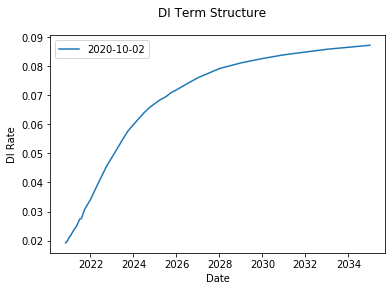

In [3]:
cur_date = '2020-10-06'
cur_di_curve = data.get_di_curve(cur_date)
cur_cc_curve = data.get_cc_curve(cur_date)
fig, ax = plt.subplots()
ax.plot(cur_di_curve['DI'], label='DI')
ax.plot(cur_cc_curve['CC'], label='CC')
fig.suptitle('DI and CC Term Structure')
ax.set_xlabel('Date')
ax.set_ylabel('Rate')
ax.legend()
plt.show()

## Update Curves ##

In [7]:
all_dates = data.dates[(data.dates['date'] >= '2016-01-03') & (data.dates['date'] <= '2020-10-06')]['date'].values

In [ ]:
start, end = '2020-10-05', '2020-10-06'

#### DI ####

In [14]:
get_curves = False

if get_curves:
    start, end = start, end
    dates = data.dates[(data.dates['date'] >= start) & (data.dates['date'] <= end)]['date'].values
    old_di_curves = pickle.load(open('di_curves.p', 'rb'))
    new_di_curves = []
    for d in dates:
        print("Current Date", d)
        di_curve = data.get_di_curve(d)
        di_curve = di_curve[['DI', 'T']].set_index('T', drop=True)
        di_curve[di_curve.index == 0] = np.nan
        di_curve.dropna(inplace=True)
        new_di_curves.append(di_curve)
    di_curves = old_di_curves + new_di_curves

In [16]:
len(di_curves), len(all_dates)

(1180, 1180)

In [17]:
save_curves = False

if save_curves:
    pickle.dump(curves, open('di_curves.p', 'wb'))

#### Cupom Cambial ####

In [33]:
get_curves = False

if get_curves:
    start, end = start, end
    dates = data.dates[(data.dates['date'] >= start) & (data.dates['date'] <= end)]['date'].values
    old_cc_curves = pickle.load(open('cc_curves.p', 'rb'))
    new_cc_curves = []
    for d in dates:
        print("Current Date", d)
        try:
            cc_curve = data.get_cc_curve(d)
            cc_curve = cc_curve[['CC', 'T']].set_index('T', drop=True)
            cc_curve[cc_curve.index == 0] = np.nan
            cc_curve.dropna(inplace=True)
            new_cc_curves.append(cc_curve)
        except KeyError:
            new_cc_curves.append(None)
    cc_curves = old_cc_curves + new_cc_curves

In [36]:
save_curves = True

if save_curves:
    pickle.dump(cc_curves, open('cc_curves.p', 'wb'))

In [34]:
dates = all_dates

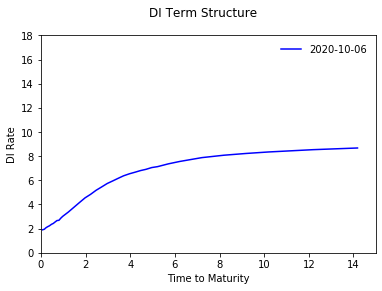

In [12]:
fig, ax = plt.subplots()
fig.suptitle('DI Term Structure')
line, = ax.plot([], [], label='Term Structure', color='blue')
legend = ax.legend(loc='upper right',frameon=False)
ax.margins(0.05)
ax.set_ylim((0, 18))
ax.set_ylabel('DI Rate')
ax.set_xlabel('Time to Maturity')

def init():
    line.set_data([],[])
    return line,

def animate(i):
    max_x = curves[i].index.max()
    max_y = curves[i]['DI'].max() * 100
    
    y = list(curves[i].values * 100)
    x = list(curves[i].index)
    
    ax.set_xlim((0, int(max_x) + 1))
    # ax.set_ylim((0, int(max_y) + 2))
    
    line.set_data(x, y)
    line.set_label(dates[i])
    ax.legend(loc='upper right', frameon=False)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=len(curves), interval=100, 
                               blit=True)
HTML(anim.to_jshtml()) 

In [137]:
# anim.save('di_term_strucuture.gif', writer='imagemagick')

MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.


## Build Features ##